In [1]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
# from datatime import datetime, timedelta
# %matplotlib inline

In [2]:
import plotly.express as px

In [3]:
#task 1(Read the data)
filename = 'E:\AI course\project individual\hotels_bookings.csv'
data = pd.read_csv(filename)
data.sample(8).T

,38582,69282,108658,32939,73839,63689,117880,115127
hotel,Resort Hotel,City Hotel,City Hotel,Resort Hotel,City Hotel,City Hotel,City Hotel,City Hotel
is_canceled,0,1,0,0,1,1,0,0
lead_time,193,184,28,0,307,15,312,162
arrival_date_year,2017,2017,2017,2017,2015,2017,2017,2017
arrival_date_month,July,May,March,February,August,February,August,June
arrival_date_week_number,29,22,13,6,34,7,32,26
arrival_date_day_of_month,20,28,30,9,20,17,6,28
stays_in_weekend_nights,0,2,0,0,0,0,2,0
stays_in_week_nights,3,3,1,1,2,2,4,4
adults,2,2,1,1,2,2,1,1


## clean data

In [4]:
#change whitespace with '_'
# data.columns = data.columns.str.replace(' ', '_') 

In [5]:
# understanding the data
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

In [6]:
#task 1   # understanding the data
data.notnull().sum()

hotel                             119390
is_canceled                       119390
lead_time                         119390
arrival_date_year                 119390
arrival_date_month                119390
arrival_date_week_number          119390
arrival_date_day_of_month         119390
stays_in_weekend_nights           119390
stays_in_week_nights              119390
adults                            119390
children                          119386
babies                            119390
meal                              119390
country                           118902
market_segment                    119390
distribution_channel              119390
is_repeated_guest                 119390
previous_cancellations            119390
previous_bookings_not_canceled    119390
reserved_room_type                119390
assigned_room_type                119390
booking_changes                   119390
deposit_type                      119390
agent                             103050
company         

In [7]:
#task 1     # understanding the data
# data[data.duplicated()].count() # there are 31994 duplicated
data[data.duplicated()].head(3)

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
5,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.00,0,1,Check-Out,2015-07-03
22,Resort Hotel,0,72,2015,July,27,1,2,4,2,...,No Deposit,250.0,NaN,0,Transient,84.67,0,1,Check-Out,2015-07-07
43,Resort Hotel,0,70,2015,July,27,2,2,3,2,...,No Deposit,250.0,NaN,0,Transient,137.00,0,1,Check-Out,2015-07-07


In [8]:
# delete duplicated
data.drop_duplicates(inplace =True)
data.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
hotel,87396,2,City Hotel,53428,NaN,NaN,NaN,NaN,NaN,NaN,NaN
is_canceled,87396.0,NaN,NaN,NaN,0.274898,0.446466,0.0,0.0,0.0,1.0,1.0
lead_time,87396.0,NaN,NaN,NaN,79.891368,86.052325,0.0,11.0,49.0,125.0,737.0
arrival_date_year,87396.0,NaN,NaN,NaN,2016.210296,0.686102,2015.0,2016.0,2016.0,2017.0,2017.0
arrival_date_month,87396,12,August,11257,NaN,NaN,NaN,NaN,NaN,NaN,NaN
arrival_date_week_number,87396.0,NaN,NaN,NaN,26.838334,13.674572,1.0,16.0,27.0,37.0,53.0
arrival_date_day_of_month,87396.0,NaN,NaN,NaN,15.815541,8.835146,1.0,8.0,16.0,23.0,31.0
stays_in_weekend_nights,87396.0,NaN,NaN,NaN,1.005263,1.031921,0.0,0.0,1.0,2.0,19.0
stays_in_week_nights,87396.0,NaN,NaN,NaN,2.625395,2.053584,0.0,1.0,2.0,4.0,50.0
adults,87396.0,NaN,NaN,NaN,1.875795,0.6265,0.0,2.0,2.0,2.0,55.0


In [9]:
# after delete duplicated
data.isnull().sum()

hotel                                 0
is_canceled                           0
lead_time                             0
arrival_date_year                     0
arrival_date_month                    0
arrival_date_week_number              0
arrival_date_day_of_month             0
stays_in_weekend_nights               0
stays_in_week_nights                  0
adults                                0
children                              4
babies                                0
meal                                  0
country                             452
market_segment                        0
distribution_channel                  0
is_repeated_guest                     0
previous_cancellations                0
previous_bookings_not_canceled        0
reserved_room_type                    0
assigned_room_type                    0
booking_changes                       0
deposit_type                          0
agent                             12193
company                           82137


#task 1  #describe nulls
After delete duplicated data
<-- This data is considered complete data -->
<-- most nulls found in company as 82137 nulls -->
<-- agent has 12193 nulls -->
<-- 452 nulls for country  -->
<-- 4 nulls for childern -->
<-- otherwise the data can be worked in -->

In [10]:
#task 1-c  countine
data.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
hotel,87396,2,City Hotel,53428,NaN,NaN,NaN,NaN,NaN,NaN,NaN
is_canceled,87396.0,NaN,NaN,NaN,0.274898,0.446466,0.0,0.0,0.0,1.0,1.0
lead_time,87396.0,NaN,NaN,NaN,79.891368,86.052325,0.0,11.0,49.0,125.0,737.0
arrival_date_year,87396.0,NaN,NaN,NaN,2016.210296,0.686102,2015.0,2016.0,2016.0,2017.0,2017.0
arrival_date_month,87396,12,August,11257,NaN,NaN,NaN,NaN,NaN,NaN,NaN
arrival_date_week_number,87396.0,NaN,NaN,NaN,26.838334,13.674572,1.0,16.0,27.0,37.0,53.0
arrival_date_day_of_month,87396.0,NaN,NaN,NaN,15.815541,8.835146,1.0,8.0,16.0,23.0,31.0
stays_in_weekend_nights,87396.0,NaN,NaN,NaN,1.005263,1.031921,0.0,0.0,1.0,2.0,19.0
stays_in_week_nights,87396.0,NaN,NaN,NaN,2.625395,2.053584,0.0,1.0,2.0,4.0,50.0
adults,87396.0,NaN,NaN,NaN,1.875795,0.6265,0.0,2.0,2.0,2.0,55.0


In [11]:
data['lead_time'].nlargest(3)

1        737
4182     709
65231    629
Name: lead_time, dtype: int64

In [12]:
data['is_repeated_guest'].nlargest(3)

13937    1
14681    1
14777    1
Name: is_repeated_guest, dtype: int64

In [13]:
data['days_in_waiting_list'].nlargest(3)

58152    391
59076    391
59085    391
Name: days_in_waiting_list, dtype: int64

outliers

lead_time 
stays_in_weekend_nights 
stays_in_week_nights 
adults 
children
babies
previous_cancellations
previous_bookings_not_canceled
booking_changes
agent **
company **
days_in_waiting_list
adr **
required_car_parking_spaces
total_of_special_requests

In [14]:
# Treat with outliers
data['lead_time'] = np.where(data['lead_time']>(data['lead_time'].quantile([.8]).values[0]+data['lead_time'].mean())*1.5 ,
                          (data['lead_time'].quantile([.8]).values[0]+data['lead_time'].mean())*1.5,
                             data['lead_time'])
data['lead_time'].describe()

count    87396.000000
mean        79.235734
std         83.555133
min          0.000000
25%         11.000000
50%         49.000000
75%        125.000000
max        341.837052
Name: lead_time, dtype: float64

In [15]:
data['stays_in_weekend_nights'] = np.where(data['stays_in_weekend_nights']>(data['stays_in_weekend_nights'].quantile([.8]).values[0]+data['stays_in_weekend_nights'].mean())*1.5 ,
                          (data['stays_in_weekend_nights'].quantile([.8]).values[0]+data['stays_in_weekend_nights'].mean())*1.5,
                             data['stays_in_weekend_nights'])
data['stays_in_weekend_nights'].describe()

count    87396.000000
mean         0.997509
std          0.988167
min          0.000000
25%          0.000000
50%          1.000000
75%          2.000000
max          4.507895
Name: stays_in_weekend_nights, dtype: float64

In [16]:
data['stays_in_week_nights'] = np.where(data['stays_in_week_nights']>(data['stays_in_week_nights'].quantile([.75]).values[0]+data['stays_in_week_nights'].mean())*1.5 ,
                          (data['stays_in_week_nights'].quantile([.75]).values[0]+data['stays_in_week_nights'].mean())*1.5,
                             data['stays_in_week_nights'])
data['stays_in_week_nights'].describe()

count    87396.000000
mean         2.599933
std          1.889047
min          0.000000
25%          1.000000
50%          2.000000
75%          4.000000
max          9.938092
Name: stays_in_week_nights, dtype: float64

In [17]:
data['adults'] = np.where(data['adults']>(data['adults'].quantile([.75]).values[0]+data['adults'].mean())*1.5 ,
                          (data['adults'].quantile([.75]).values[0]+data['adults'].mean())*1.5,
                             data['adults'])
data['adults'].describe()

count    87396.000000
mean         1.872321
std          0.513170
min          0.000000
25%          2.000000
50%          2.000000
75%          2.000000
max          5.813693
Name: adults, dtype: float64

In [18]:
# data['children'].value_counts().to_dict() # there is only one outlier = 10 so we will remove it only
# if we deal with it like other outliers it will be 0 childern in all rows
data['children'] = np.where(data['children']> 4,1,data['children'])
data['children'].describe()

count    87392.000000
mean         0.138537
std          0.454668
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          3.000000
Name: children, dtype: float64

In [19]:
# data['babies'].value_counts().to_dict() # there is only two outliers = 10,9 so we will with them only
# if we deal with them like other outliers it will be 0 babies in all rows
data['babies'] = np.where(data['babies']> 4,1,data['babies'])
data['babies'].describe()

count    87396.000000
mean         0.010630
std          0.104212
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          2.000000
Name: babies, dtype: float64

In [20]:
data['previous_cancellations'] = np.where(data['previous_cancellations']>(data['previous_cancellations'].quantile([.75]).values[0]+data['previous_cancellations'].mean())*1.5 ,
                          (data['previous_cancellations'].quantile([.85]).values[0]+data['previous_cancellations'].mean())*1.5,
                             data['previous_cancellations'])
data['previous_cancellations'].describe()

count    87396.000000
mean         0.000880
std          0.006273
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          0.045620
Name: previous_cancellations, dtype: float64

In [21]:
data['previous_bookings_not_canceled'] = np.where(data['previous_bookings_not_canceled']>(data['previous_bookings_not_canceled'].quantile([.75]).values[0]+data['previous_bookings_not_canceled'].mean())*1.5 ,
                          (data['previous_bookings_not_canceled'].quantile([.85]).values[0]+data['previous_bookings_not_canceled'].mean())*1.5,
                             data['previous_bookings_not_canceled'])
data['previous_bookings_not_canceled'].describe()

count    87396.000000
mean         0.011195
std          0.054445
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          0.275985
Name: previous_bookings_not_canceled, dtype: float64

In [22]:
data['booking_changes'] = np.where(data['booking_changes']>
                                   (data['booking_changes'].quantile([.75]).values[0]+data['booking_changes'].mean())*1.5 ,
                          (data['booking_changes'].quantile([.85]).values[0]+data['booking_changes'].mean())*1.5,
                             data['booking_changes'])
data['booking_changes'].describe()

count    87396.000000
mean         0.347059
std          0.735892
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.907404
Name: booking_changes, dtype: float64

In [23]:
data['days_in_waiting_list'] = np.where(data['days_in_waiting_list']>
                                   (data['days_in_waiting_list'].quantile([.75]).values[0]+data['days_in_waiting_list'].mean())*1.5 ,
                          (data['days_in_waiting_list'].quantile([.85]).values[0]+data['days_in_waiting_list'].mean())*1.5,
                             data['days_in_waiting_list'])
data['days_in_waiting_list'].describe()

count    87396.000000
mean         0.011047
std          0.110822
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.124348
Name: days_in_waiting_list, dtype: float64

In [24]:
data['required_car_parking_spaces'] = np.where(data['required_car_parking_spaces']>
                                   (data['required_car_parking_spaces'].quantile([.75]).values[0]+data['required_car_parking_spaces'].mean())*1.5 ,
                          (data['required_car_parking_spaces'].quantile([.75]).values[0]+data['required_car_parking_spaces'].mean())*1.5,
                             data['required_car_parking_spaces'])
data['required_car_parking_spaces'].describe()

count    87396.000000
mean         0.010572
std          0.034984
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          0.126339
Name: required_car_parking_spaces, dtype: float64

In [25]:
data['total_of_special_requests'] = np.where(data['total_of_special_requests']>
                                   (data['total_of_special_requests'].quantile([.75]).values[0]+data['total_of_special_requests'].mean())*1.5 ,
                          (data['total_of_special_requests'].quantile([.75]).values[0]+data['total_of_special_requests'].mean())*1.5,
                             data['total_of_special_requests'])
data['total_of_special_requests'].describe()

count    87396.000000
mean         0.680253
std          0.780028
min          0.000000
25%          0.000000
50%          0.000000
75%          1.000000
max          2.547851
Name: total_of_special_requests, dtype: float64

In [26]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 87396 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   hotel                           87396 non-null  object 
 1   is_canceled                     87396 non-null  int64  
 2   lead_time                       87396 non-null  float64
 3   arrival_date_year               87396 non-null  int64  
 4   arrival_date_month              87396 non-null  object 
 5   arrival_date_week_number        87396 non-null  int64  
 6   arrival_date_day_of_month       87396 non-null  int64  
 7   stays_in_weekend_nights         87396 non-null  float64
 8   stays_in_week_nights            87396 non-null  float64
 9   adults                          87396 non-null  float64
 10  children                        87392 non-null  float64
 11  babies                          87396 non-null  int64  
 12  meal                           

In [27]:
data.describe(include ='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
hotel,87396,2,City Hotel,53428,NaN,NaN,NaN,NaN,NaN,NaN,NaN
is_canceled,87396.0,NaN,NaN,NaN,0.274898,0.446466,0.0,0.0,0.0,1.0,1.0
lead_time,87396.0,NaN,NaN,NaN,79.235734,83.555133,0.0,11.0,49.0,125.0,341.837052
arrival_date_year,87396.0,NaN,NaN,NaN,2016.210296,0.686102,2015.0,2016.0,2016.0,2017.0,2017.0
arrival_date_month,87396,12,August,11257,NaN,NaN,NaN,NaN,NaN,NaN,NaN
arrival_date_week_number,87396.0,NaN,NaN,NaN,26.838334,13.674572,1.0,16.0,27.0,37.0,53.0
arrival_date_day_of_month,87396.0,NaN,NaN,NaN,15.815541,8.835146,1.0,8.0,16.0,23.0,31.0
stays_in_weekend_nights,87396.0,NaN,NaN,NaN,0.997509,0.988167,0.0,0.0,1.0,2.0,4.507895
stays_in_week_nights,87396.0,NaN,NaN,NaN,2.599933,1.889047,0.0,1.0,2.0,4.0,9.938092
adults,87396.0,NaN,NaN,NaN,1.872321,0.51317,0.0,2.0,2.0,2.0,5.813693


## project 2

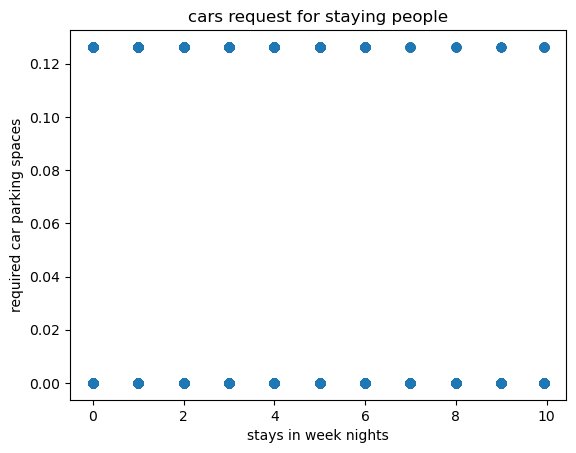

In [28]:
#1
plt.scatter(data['stays_in_week_nights'], data['required_car_parking_spaces']) 
plt.xlabel('stays in week nights') 
plt.ylabel('required car parking spaces') 
plt.title('cars request for staying people') 
plt.show()

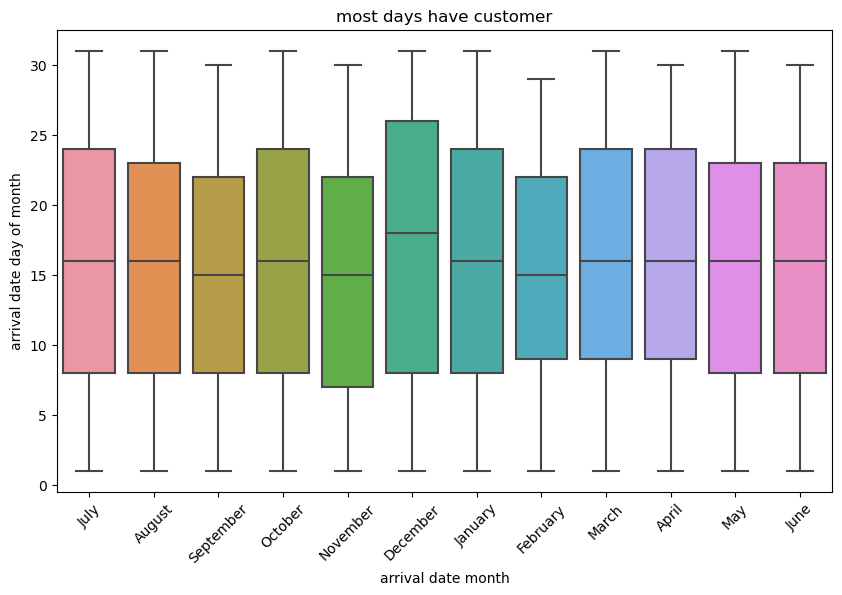

In [29]:
#2
plt.figure(figsize=(10, 6)) 
sns.boxplot(x='arrival_date_month', y='arrival_date_day_of_month', data=data) 
plt.xticks(rotation=45) 
plt.xlabel('arrival date month') 
plt.ylabel('arrival date day of month') 
plt.title('most days have customer') 
plt.show()

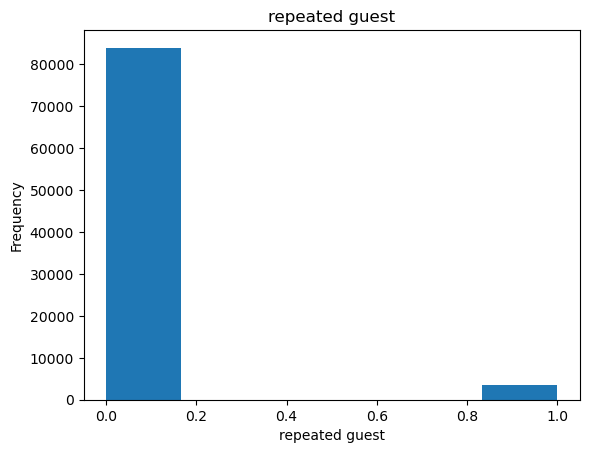

In [30]:
#3
plt.hist(data['is_repeated_guest'], bins=6) 
plt.xlabel('repeated guest') 
plt.ylabel('Frequency') 
plt.title('repeated guest') 
plt.show()

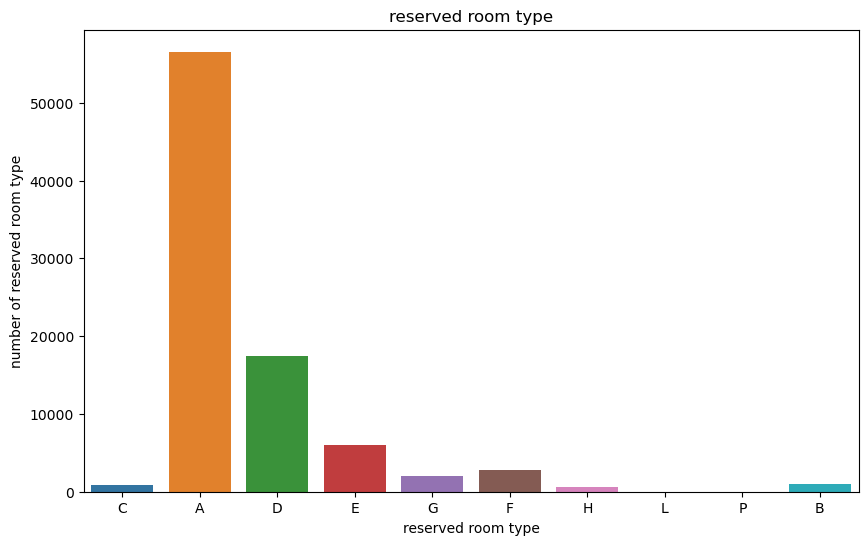

In [31]:
#4
plt.figure(figsize=(10, 6)) 
sns.countplot(x='reserved_room_type', data=data) 
plt.xlabel('reserved room type') 
plt.ylabel('number of reserved room type') 
plt.title('reserved room type') 
plt.show()

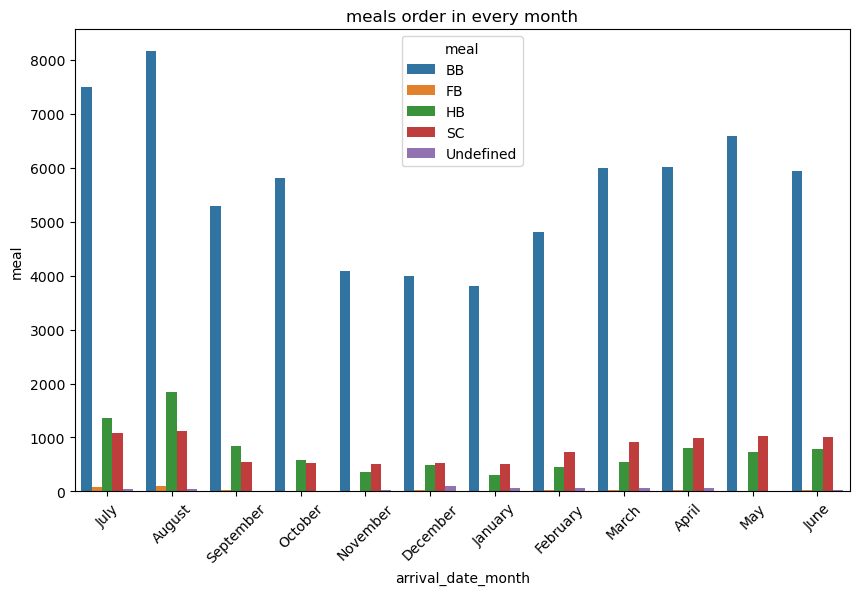

In [32]:
#5
plt.figure(figsize=(10, 6)) 
sns.countplot(x='arrival_date_month', hue='meal', data=data) 
plt.xlabel('arrival_date_month') 
plt.ylabel('meal') 
plt.title('meals order in every month') 
plt.xticks(rotation=45) 
plt.legend(title='meal') 
plt.show()

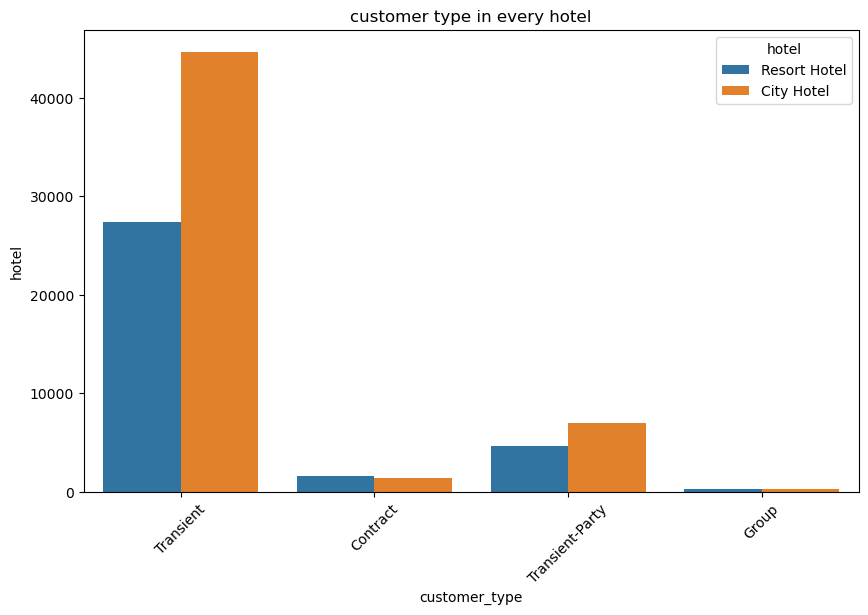

In [33]:
#6
plt.figure(figsize=(10, 6)) 
sns.countplot(x='customer_type', hue='hotel', data=data) 
plt.xlabel('customer_type') 
plt.ylabel('hotel') 
plt.title('customer type in every hotel') 
plt.xticks(rotation=45) 
plt.legend(title='hotel') 
plt.show()

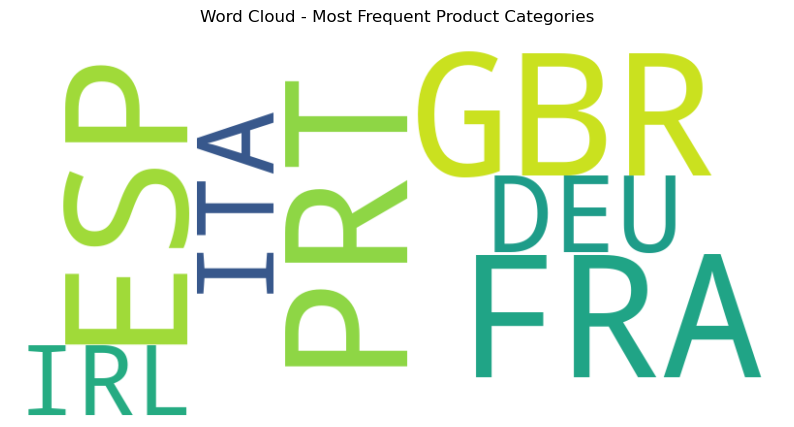

In [34]:
#7
x=data['country'].value_counts()[:7].index.tolist()
from wordcloud import WordCloud 
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(' '.join(x)) 
plt.figure(figsize=(10, 6)) 
plt.imshow(wordcloud, interpolation='bilinear') 
plt.axis('off') 
plt.title('Word Cloud - Most Frequent Product Categories') 
plt.show()

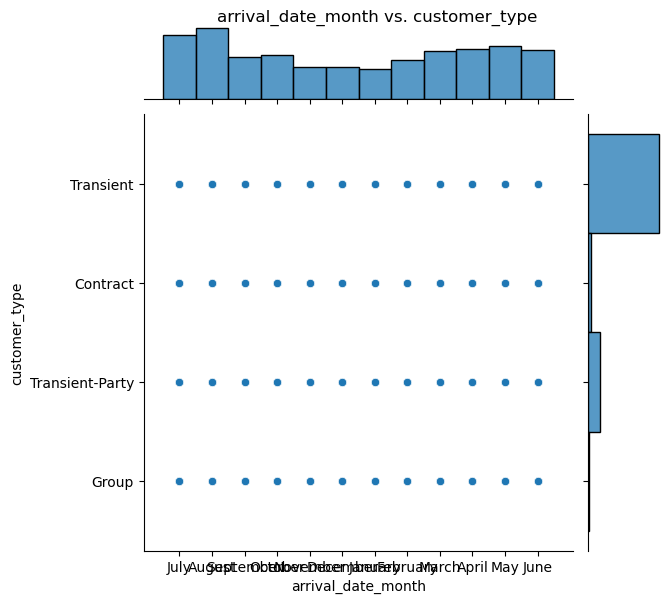

In [35]:
#8
sns.jointplot(x='arrival_date_month', y='customer_type', data=data) 
plt.xlabel('arrival_date_month') 
plt.ylabel('customer_type') 

plt.suptitle('arrival_date_month vs. customer_type',y=0.999) 
plt.show()

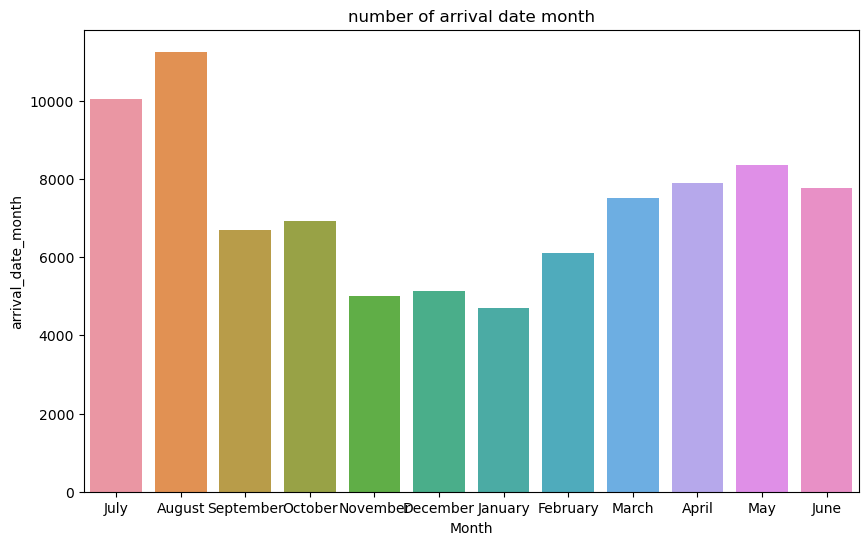

In [36]:
#9
plt.figure(figsize=(10, 6)) 
sns.countplot(x='arrival_date_month', data=data) 
plt.xlabel('Month') 
plt.ylabel('arrival_date_month') 
plt.title('number of arrival date month') 
plt.show()

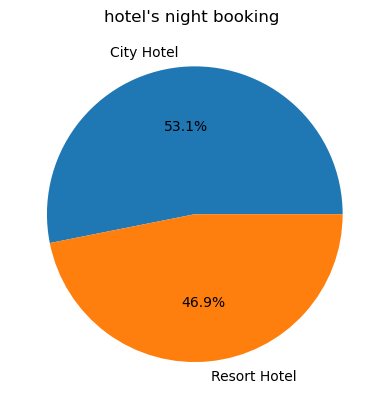

In [37]:
#see every hotel visitors   10
hotel_popularity = data.groupby('hotel')['stays_in_week_nights'].sum()
plt.pie(hotel_popularity,labels=hotel_popularity.index,autopct='%1.1f%%')
plt.title('hotel\'s night booking ')
plt.show()

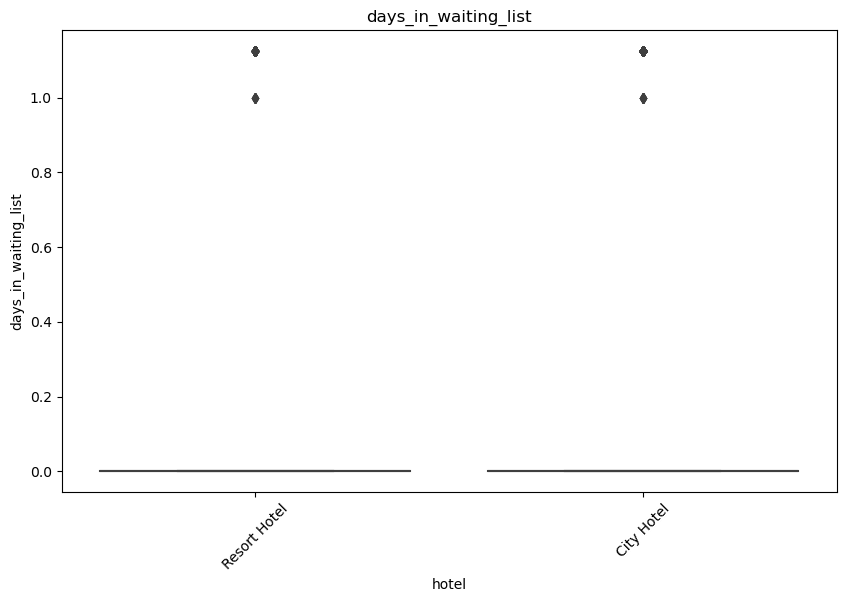

In [38]:
#11
plt.figure(figsize=(10, 6)) 
sns.boxplot(x='hotel', y='days_in_waiting_list', data=data) 
plt.xticks(rotation=45) 
plt.xlabel('hotel') 
plt.ylabel('days_in_waiting_list') 
plt.title('days_in_waiting_list') 
plt.show()

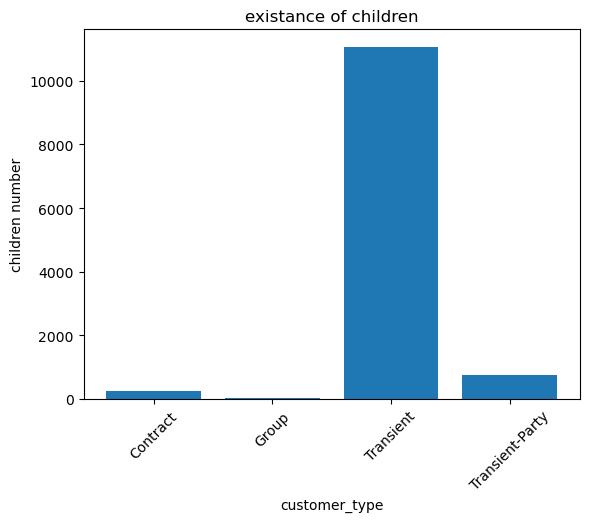

In [39]:
#12
top_3_categories = data.groupby('customer_type')['children'].sum() 

fig, ax = plt.subplots()

plt.bar(top_3_categories.index, top_3_categories.values) 
plt.xticks(rotation=45)  # rotate the names on X-axis
plt.xlabel('customer_type')   # X-label
plt.ylabel('children number') # y-label
plt.title('existance of children')
# ax.legend(title='existance of children')

plt.show()

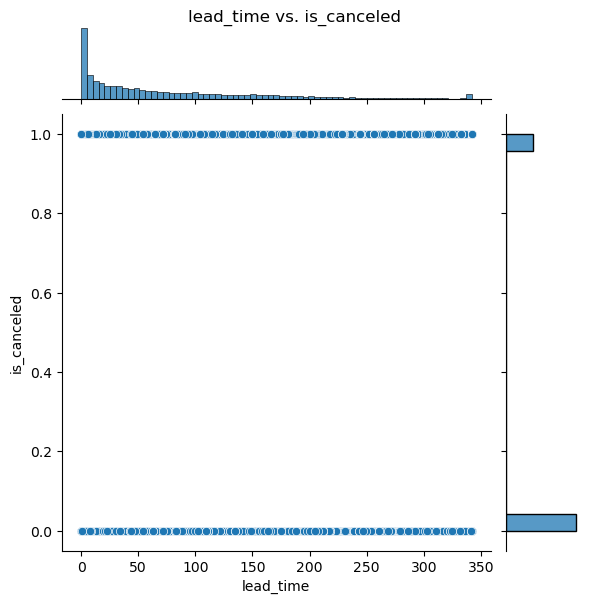

In [40]:
#13
sns.jointplot(x='lead_time', y='is_canceled', data=data) 
plt.xlabel('lead_time') 
plt.ylabel('is_canceled') 

plt.suptitle('lead_time vs. is_canceled',y=0.999) 
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


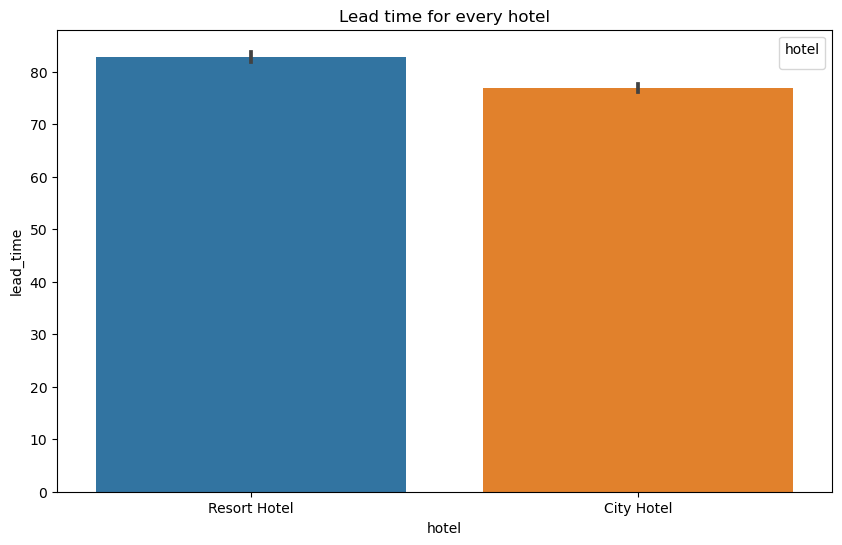

In [41]:
#14
plt.figure(figsize=(10, 6)) 
sns.barplot(x='hotel', y='lead_time', data=data
#            , hue='hotel'
           ) 
plt.xlabel('hotel') 
plt.ylabel('lead_time') 
plt.title('Lead time for every hotel') 
plt.legend(title='hotel', bbox_to_anchor=(1, 1)) 
plt.show()

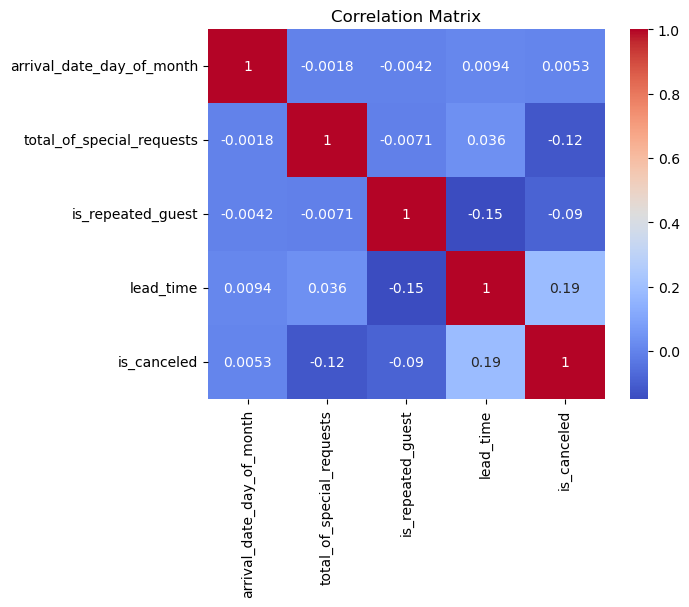

In [42]:
#15
correlation_matrix = data[['arrival_date_day_of_month','total_of_special_requests','is_repeated_guest','lead_time','is_canceled']].corr() 
sns.heatmap(correlation_matrix, 
            annot=True,
             cmap='coolwarm'
             ) 
plt.title('Correlation Matrix') 
plt.show()

In [43]:
# data['country'].value_counts()[:5].index.tolist()

In [44]:
# data['arrival_date_month']=data['arrival_date_month'].astype('string')

In [45]:
# data['children'].quantile([0.95])
# data['country'].unique()

In [46]:
# data.replace(to_replace='and', value='&', inplace=False)
# data.describe()

In [47]:
data['reservation_status'].value_counts().to_dict()

{'Check-Out': 63371, 'Canceled': 23011, 'No-Show': 1014}

In [48]:
data['arrival_date_year'].describe()

count    87396.000000
mean      2016.210296
std          0.686102
min       2015.000000
25%       2016.000000
50%       2016.000000
75%       2017.000000
max       2017.000000
Name: arrival_date_year, dtype: float64

## project3 

### 1st sns

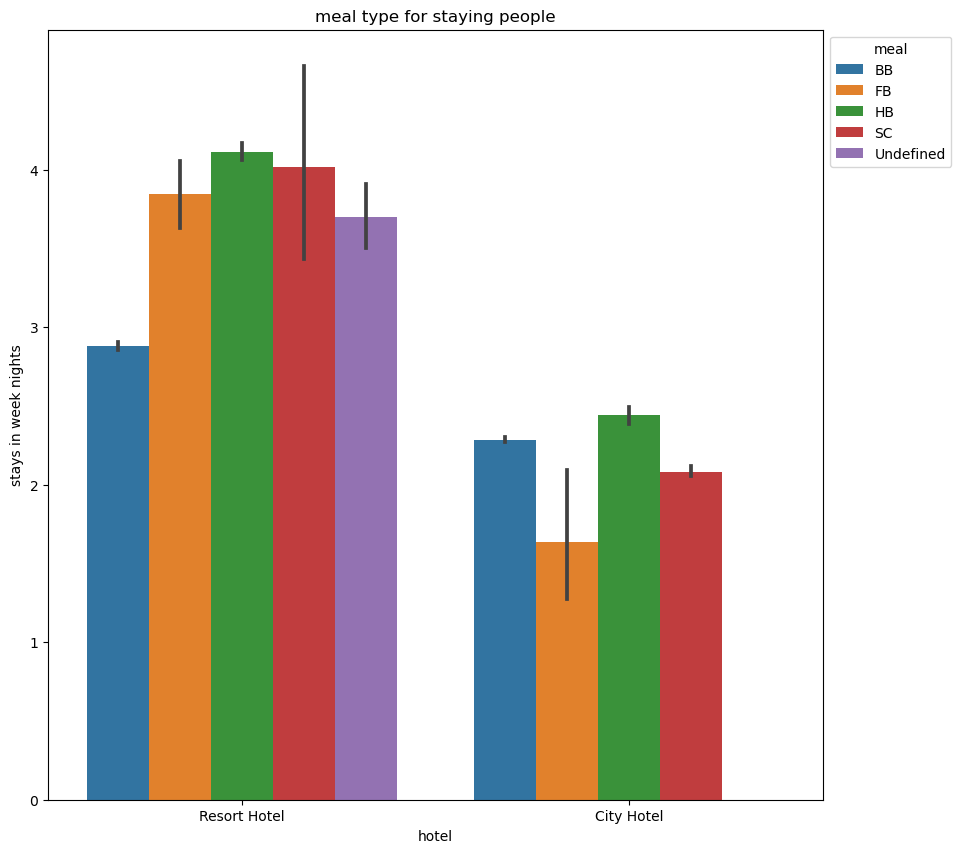

In [49]:
plt.figure(figsize=(10,10))
sns.barplot(x='hotel',y='stays_in_week_nights',hue='meal',data=data)
plt.xlabel('hotel')
plt.ylabel('stays in week nights')
plt.title('meal type for staying people') 
plt.legend(title='meal', bbox_to_anchor=(1, 1)) 
plt.show()

### 2nd sns 

Text(0.5, 0.0, 'stayong for day number and customer type')

<Figure size 1000x1000 with 0 Axes>

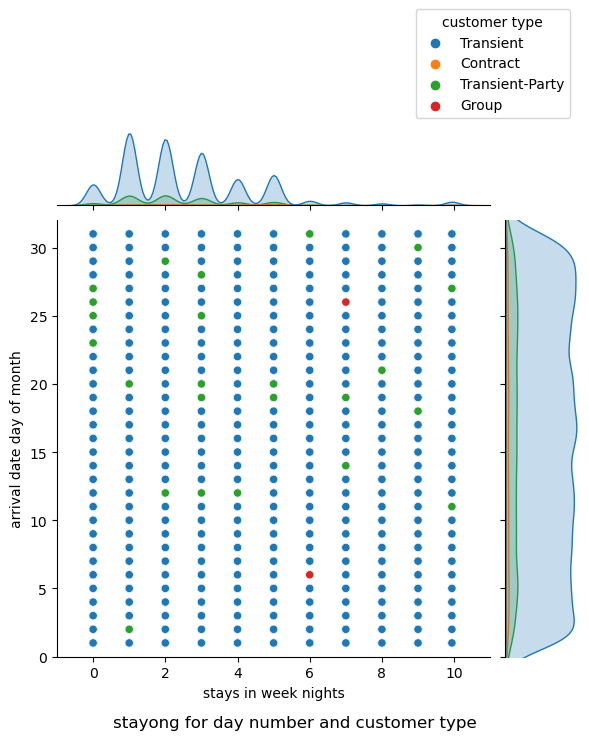

In [50]:
plt.figure(figsize=(10,10))
sns.jointplot(x='stays_in_week_nights', y='arrival_date_day_of_month',hue ='customer_type' ,data=data,xlim=[-1,11],ylim=[0,32]) 
plt.xlabel('stays in week nights') 
plt.ylabel('arrival date day of month') 
plt.legend(title='customer type', bbox_to_anchor=(1.2,1.5)) 
plt.suptitle('stayong for day number and customer type',y=0.0)

### Plotly

### 1

In [51]:
fig = px.pie(data ,names='customer_type')
fig.show()

### 2

In [52]:
fig = px.scatter(data ,x='deposit_type',width =600,height = 500, y='arrival_date_day_of_month',color="hotel")
fig.show()

### 3

In [53]:
fig = px.scatter(data,width =900,height = 600, x='lead_time', y='is_canceled',color='hotel',
                 trendline="ols")
fig.show()

### 4

In [56]:
fig = px.line(data , x='previous_cancellations' ,color='hotel',y='is_canceled',width =600,height = 600)
fig.show()